<h1><center>Race Strategy Simulation</center></h1>

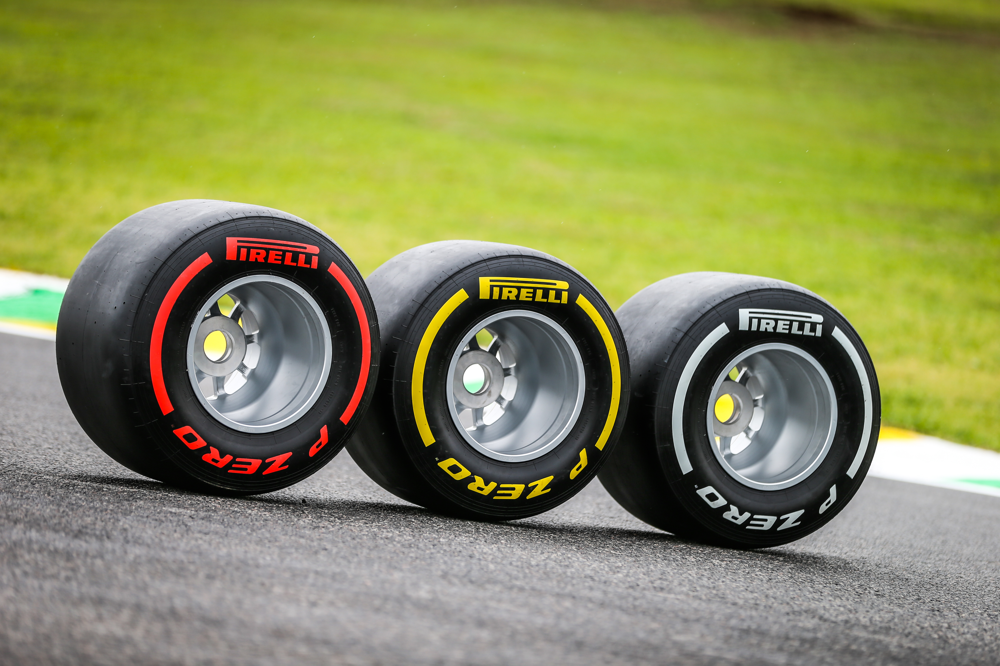

This notebook demonstrates the simulations that the API will run to determine the best Formula1 race strategy given a a certain number of laps and temperature. 

<h2>Model Description<h2>

In our hypothetical scenario, we model a car that must perform a certain number of laps around a track. The car must make 1 pit stop and must use two different compounds (tire types). They are three compounds available, soft, medium and hard tires. After each lap, the tires will begin to degrade and offer less grip resulting in slower lap times. 

Softer compounds offer the more grip than harder compounds which makes them faster as a result. That being said, the harder compounds have more durability and after a certain number of laps the soft tires will degrade to the point that they are lapping slower than harder compounds. In a real racing scenario this depends on many factors such as car design, temperature, humidity etc. For our hypothetical scenario we will assume that only temperature effects the rate at which the tires degrade. The goal of our simulation is to find the best combination of compounds and the best lap at which we should pit. 

The snippet below plots the lap times of the hypothetical compounds that we have. First we define two helper functions, one that gets the degradation factor at a given temperature for each compound. The second calculates the lap time at a given lap for a given degradation factor.

In [1]:
import matplotlib.pyplot as plt
import math
from enum import Enum

class Compound(Enum):
    SOFT = 1
    MEDIUM = 2
    HARD = 3


TEMP_FACTOR = {Compound.SOFT: 1/(3), Compound.MEDIUM: 1/(6**2), Compound.HARD: 1/(7**3)}
COMPOUND_BEST_LAP = {Compound.SOFT: 90, Compound.MEDIUM: 91, Compound.HARD: 92}


def degradation_factor(temp, compound):
    if temp < 1:
        temp = 1
    return round((temp * TEMP_FACTOR[compound]) + (math.log(temp, 10)), 2)


def lap_time(deg_factor, compound, lap):
    return COMPOUND_BEST_LAP[compound] + (deg_factor * ((lap**2)/1000))


lap_times_15 = {f"{compound}": [lap_time(degradation_factor(15,compound),compound,lap) for lap in range(71)] for compound in Compound}
lap_times_30 = {f"{compound}": [lap_time(degradation_factor(30,compound),compound,lap) for lap in range(71)] for compound in Compound}

We know have two dictionaries that each hold the lap times for each compound and 15 and 30 degrees respectively. We can plot the laptimes to see how the times decrease over time for our model.

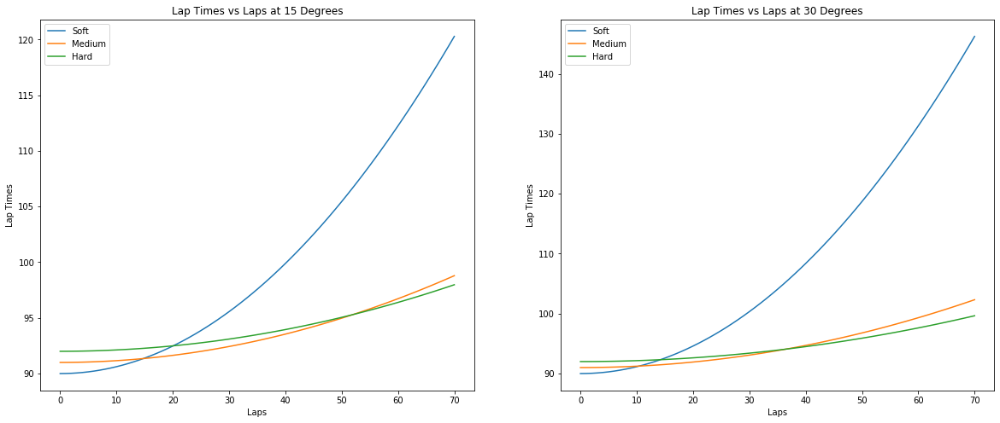

In [5]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize = (20,8))


ax1.set_title("Lap Times vs Laps at 15 Degrees")
ax1.set_xlabel('Laps')
ax1.set_ylabel('Lap Times')
ax1.plot(lap_times_15['Compound.SOFT'],label="Soft")
ax1.plot(lap_times_15['Compound.MEDIUM'],label="Medium")
ax1.plot(lap_times_15['Compound.HARD'],label="Hard")
ax1.legend()

ax2.set_title("Lap Times vs Laps at 30 Degrees")
ax2.set_xlabel('Laps')
ax2.set_ylabel('Lap Times')
ax2.plot(lap_times_30['Compound.SOFT'],label="Soft")
ax2.plot(lap_times_30['Compound.MEDIUM'],label="Medium")
ax2.plot(lap_times_30['Compound.HARD'],label="Hard")
ax2.legend()

plt.show()

The charts above illustrate the behavior of the tires for our model. At cooler temperatures, the softer compounds have more duration. 
At 30 degrees the starts lapping slower than the medium at around lap 10 whereas at 15 degrees this only starts to happen at around lap 15.

<h2>Simulations<h2>

We will now simulate all the strategies available and chose the best one. We will explore all combinations of compounds, and for each compound explore each lap at which we can pit to change tires. Pitting can not be done on the last lap. The snippet below will simulate a 70 lap race at 25 degrees. 

In [119]:
from typing import List
from pydantic import BaseModel


class Strategy(BaseModel):
    compound_1: str
    compound_2: str
    pit_lap: int
    race_time: float

The functions below are helper functions to get the quickest lap time at a given temperature and race length (laps).

In [120]:
def strategy_min(strategy_times: List[Strategy]) -> Strategy:
    quickest_strategy = min(
        strategy_times, key=lambda strategy_times: strategy_times.race_time
    )
    return quickest_strategy


def compound_optimal(tire_1,tire_2,laps,temp):
    strategy_times = []
    deg_1 = degradation_factor(temp,tire_1)
    deg_2 = degradation_factor(temp,tire_2)
    for pit_stop in range(1,laps-1):
        race_time = 0
        for lap in range(0, laps+1):
            if lap < pit_stop:
                race_time += lap_time(deg_1, tire_1, lap)
            else:
                race_time += lap_time(deg_2, tire_2, lap)
        strategy = Strategy(compound_1=tire_1.name,
                            compound_2=tire_2.name,
                            pit_lap=pit_stop,
                            race_time=race_time)
        strategy_times.append(strategy)
    return strategy_min(strategy_times)
    

def best_strategy(temp, laps):
    strategy_times = []
    for tire_1 in Compound:
        for tire_2 in Compound:
            if tire_1 != tire_2:
                best_strategy = compound_optimal(tire_1,tire_2,laps,temp)
                strategy_times.append(best_strategy)
    return strategy_min(strategy_times)

We can use the best_strategy to get the quickest race time and when we should pit.

In [128]:
quickest_time = best_strategy(temp=25,laps=70)
quickest_time

Strategy(compound_1='MEDIUM', compound_2='HARD', pit_lap=41, race_time=6676.415450000002)

The above function is what will be called by our FastAPI application. We will get laps and a location from the body of the request. We will then get the temperature from the weather API and then calculate the best time.

<h2>Simulation Visualization<h2>

The two function below are a variation on the functions that get the best time. These functions will get all compound and pit lap permutations which 
can be used to visualize the different strategies.

In [126]:
def compound_times(tire_1,tire_2,laps,temp):
    strategy_times = []
    deg_1 = degradation_factor(temp,tire_1)
    deg_2 = degradation_factor(temp,tire_2)
    for pit_stop in range(1,laps-1):
        race_time = 0
        for lap in range(0, laps+1):
            if lap < pit_stop:
                race_time += lap_time(deg_1, tire_1, lap)
            else:
                race_time += lap_time(deg_2, tire_2, lap)
        strategy_times.append(race_time)
    return strategy_times
    

def all_times(temp, laps):
    strategy_times = {}
    for tire_1 in Compound:
        for tire_2 in Compound:
            if tire_1 != tire_2:
                times = compound_times(tire_1,tire_2,laps,temp)
                strategy_times[f'{tire_1.name}-{tire_2.name}'] = times
    return strategy_times

In [127]:
simulations = all_times(25,70)

Text(0.5, 1, 'HARD-SOFT Race Time')

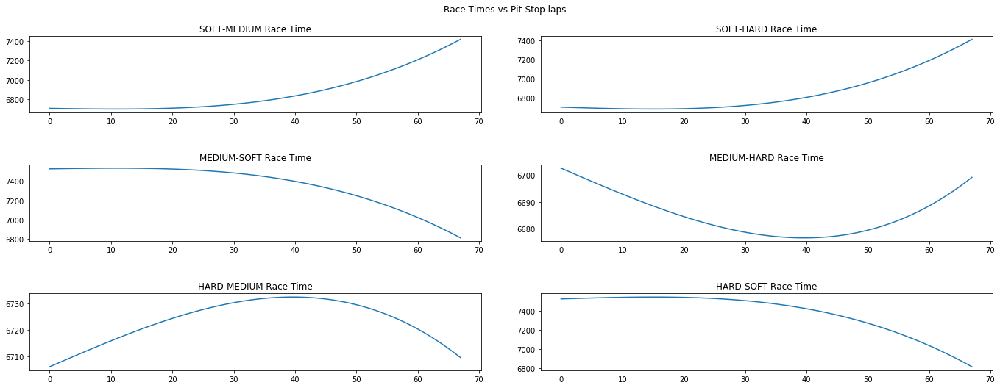

In [129]:
fig, ((ax1, ax2), (ax3, ax4), (ax5,ax6)) = plt.subplots(3, 2, figsize = (20,8))
fig.suptitle('Race Times vs Pit-Stop laps')
fig.tight_layout(pad=5.0)
ax1.plot(simulations['SOFT-MEDIUM'])
ax1.set_title('SOFT-MEDIUM Race Time')
ax2.plot(simulations['SOFT-HARD'])
ax2.set_title('SOFT-HARD Race Time')
ax3.plot(simulations['MEDIUM-SOFT'])
ax3.set_title('MEDIUM-SOFT Race Time')
ax4.plot(simulations['MEDIUM-HARD'])
ax4.set_title('MEDIUM-HARD Race Time')
ax5.plot(simulations['HARD-MEDIUM'])
ax5.set_title('HARD-MEDIUM Race Time')
ax6.plot(simulations['HARD-SOFT'])
ax6.set_title('HARD-SOFT Race Time')

The graphs plot Race Times vs Pit Laps. It is an interesting way to visualize how the total time changes with the choice of compound and when you decide to pit. Just from looking at the charts we can see the quickest time can be achieved by starting on the medium and then pitting for hards on lap 41. 